# SVM и его ядра

В этом задании нам предстоит решить задачу SVM при помощи `cvxopt` и применить ее к искуственным данным. Затем аналогичным способом нужно будет решить задачу ядерного SVM и исследовать его поведение для различных ядер и значений их параметров.

In [1]:
import random
from typing import Callable

import matplotlib.pyplot as plt
import numpy as np
from cvxopt import matrix, solvers
from sklearn.datasets import make_blobs, make_moons

solvers.options["show_progress"] = False

In [2]:
SEED = 7
np.random.seed(SEED)
random.seed(SEED)

In [3]:
def visualize(clf, X, y):
    x_min, x_max = X[:, 0].min(), X[:, 0].max()
    y_min, y_max = X[:, 1].min(), X[:, 1].max()
    x_border = (x_max - x_min) / 20 + 1.0e-3
    x_h = (x_max - x_min + 2 * x_border) / 200
    y_border = (y_max - y_min) / 20 + 1.0e-3
    y_h = (y_max - y_min + 2 * y_border) / 200

    cm = plt.cm.Spectral

    xx, yy = np.meshgrid(
        np.arange(x_min - x_border, x_max + x_border, x_h), np.arange(y_min - y_border, y_max + y_border, y_h)
    )
    mesh = np.c_[xx.ravel(), yy.ravel()]

    z_class = clf.predict(mesh).reshape(xx.shape)

    # Put the result into a color plot
    plt.figure(1, figsize=(8, 8))
    plt.pcolormesh(xx, yy, z_class, cmap=cm, alpha=0.3, shading="gouraud")

    # Plot hyperplane and margin
    z_dist = clf.decision_function(mesh).reshape(xx.shape)
    plt.contour(xx, yy, z_dist, [0.0], colors="black")
    plt.contour(xx, yy, z_dist, [-1.0, 1.0], colors="black", linestyles="dashed")

    # Plot also the training points
    y_pred = clf.predict(X)

    ind_support = []
    ind_correct = []
    ind_incorrect = []
    for i in range(len(y)):
        if i in clf.support:
            ind_support.append(i)
        elif y[i] == y_pred[i]:
            ind_correct.append(i)
        else:
            ind_incorrect.append(i)

    plt.scatter(
        X[ind_correct, 0], X[ind_correct, 1], c=y[ind_correct], cmap=cm, alpha=1.0, edgecolor="black", linewidth=0.8
    )
    plt.scatter(
        X[ind_incorrect, 0],
        X[ind_incorrect, 1],
        c=y[ind_incorrect],
        cmap=cm,
        alpha=1.0,
        marker="*",
        s=50,
        edgecolor="black",
        linewidth=0.8,
    )
    plt.scatter(
        X[ind_support, 0],
        X[ind_support, 1],
        c=y[ind_support],
        cmap=cm,
        alpha=1.0,
        edgecolor="yellow",
        linewidths=1.0,
        s=40,
    )

    plt.xlim(xx.min(), xx.max())
    plt.ylim(yy.min(), yy.max())
    plt.tight_layout()

In [4]:
def generate_moons_dataset(n_points=1000, noise=0.075):
    X, y = make_moons(n_points, noise=noise, random_state=SEED)
    return X, 2 * y - 1

def generate_blobs_dataset(n_points=1000, n_features=2):
    X, y = make_blobs(n_points, n_features, centers=[[0, 0], [-4, 2], [3.5, -2.0], [3.5, 3.5]], random_state=SEED)
    y = 2 * (y % 2) - 1
    return X, y

X_moons, y_moons = generate_moons_dataset()
X_blobs, y_blobs = generate_blobs_dataset()

### Задание 1 (2 балла)
Для начала реализуем обычный линейный SVM.

#### Методы
`fit(X, y)` - обучает SVM, решая задачу оптимизации при помощи `cvxopt.solvers.qp`

`decision_function(X)` - возвращает значение решающей функции (т.е. то число, от которого берем знак с целью узнать класс)

#### Поля
`support` - индексы опорных элементов

### Решение с помощью QP Solver

QP-solver решает такую задачу:

$\begin{cases}0.5 \cdot x^\text{T}Px + q^\text{T}x\rightarrow \min_x\\Gx \leq h\\Ax=b\end{cases}$

А наша задача формулируется так:

$\begin{cases}0.5 \cdot w^\text{T}w + C \cdot \sum \xi_i \rightarrow \min_{w, \xi} \\ \xi \geq 0 \\ y_i (w^\text{T}x_i + w_0) \geq 1 - \xi_i \end{cases}$

Сведем ее к задаче QP-solver'а:

$ x = (w, w_0, \xi) \\ P =
\left[
    \begin{array}{c|c}
      I & 0\\
      \hline
      0 & 0
    \end{array}
\right] \\
q = \left[
    \begin{array}{c}
      0 \\
      \hline
      C
    \end{array}
\right] \\
 G =
\left[
    \begin{array}{c|c|c}
      0 & 0 & -I\\
      \hline
      -yX & -y & -I
    \end{array}
\right] \\ h = \left[
    \begin{array}{c}
      0 \\
      \hline
      -1
    \end{array}
\right] $

In [5]:
class LinearSVM:
    def __init__(self, C: float):
        """SVM with linear kernel

        Args:
            C: Soft margin coefficient.
        """
        self.C = C
        self.support = None
        self._weights = None
        self._bias = None

    def fit(self, X: np.ndarray, y: np.ndarray):
        """Fit SVM using cvxopt.solvers.qp

        Args:
            X: Train data, [n_samles, n_features]
            y: Binary labels (-1 or +1), [n_samples,]
        """
        n_samples, n_features = X.shape
        y = y.reshape(-1, 1)

        top_block = np.block([
            [np.eye(n_features), np.zeros((n_features, n_samples + 1))],
            [np.zeros((n_samples + 1, n_features)), np.zeros((n_samples + 1, n_samples + 1))]
        ])
        
        P = matrix(top_block)


        q = np.hstack([
            np.zeros(n_features + 1),
            np.ones(n_samples) * self.C
        ])
        Q = matrix(q)


        G_upper = np.hstack([
            np.zeros((n_samples, n_features)),  
            np.zeros((n_samples, 1)),           
            -np.eye(n_samples)                  
        ])

        G_lower = np.hstack([
            -y * X,       
            -y,            
            -np.eye(n_samples)  
        ])

        G = matrix(np.vstack([G_upper, G_lower]))

        h_upper = np.zeros((n_samples, 1))      
        h_lower = -np.ones((n_samples, 1))     
        h = matrix(np.vstack([h_upper, h_lower]))

        solution = solvers.qp(P, Q, G, h)
        solution_vector = np.array(solution['x']).flatten()

        self._weights = solution_vector[:n_features]
        self._bias = solution_vector[n_features]
        epsilon = solution_vector[n_features + 1: n_features + 1 + n_samples]

        epsilon_tolerance = 1e-3
        self.support = [i for i in range(len(epsilon)) if epsilon[i] > epsilon_tolerance]


    def decision_function(self, X: np.ndarray) -> np.ndarray:
        """Calculate decision for the points, i.e. prediction without sign

        Args:
            X: Input data, [n_samples, n_features]

        Return:
            Decision for each input point, [n_samples, ]
        """
        if self._weights is None or self._bias is None:
            raise ValueError("Model not fitted")
        
        return X @ self._weights + self._bias


    def predict(self, X: np.ndarray) -> np.ndarray:
        """Classify input points

        Args:
            X: Input data, [n_samples, n_features]

        Return:
            Predicited class for each point (-1 or +1), [n_samples, ]
        """
        decisions = self.decision_function(X)
        return np.sign(decisions)


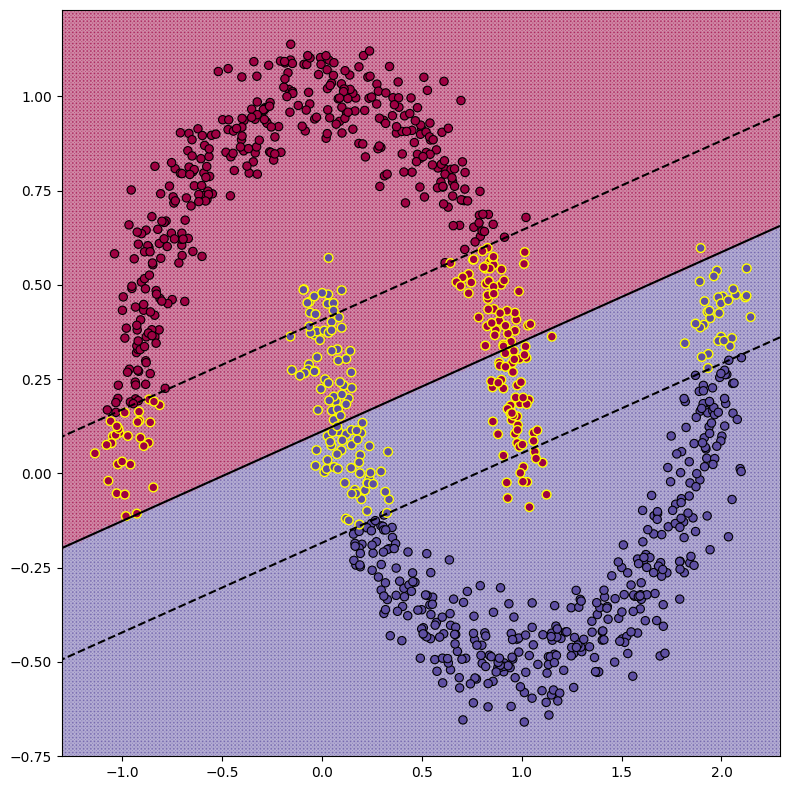

In [6]:
svm = LinearSVM(1)
svm.fit(X_moons, y_moons)
visualize(svm, X_moons, y_moons)
plt.show()

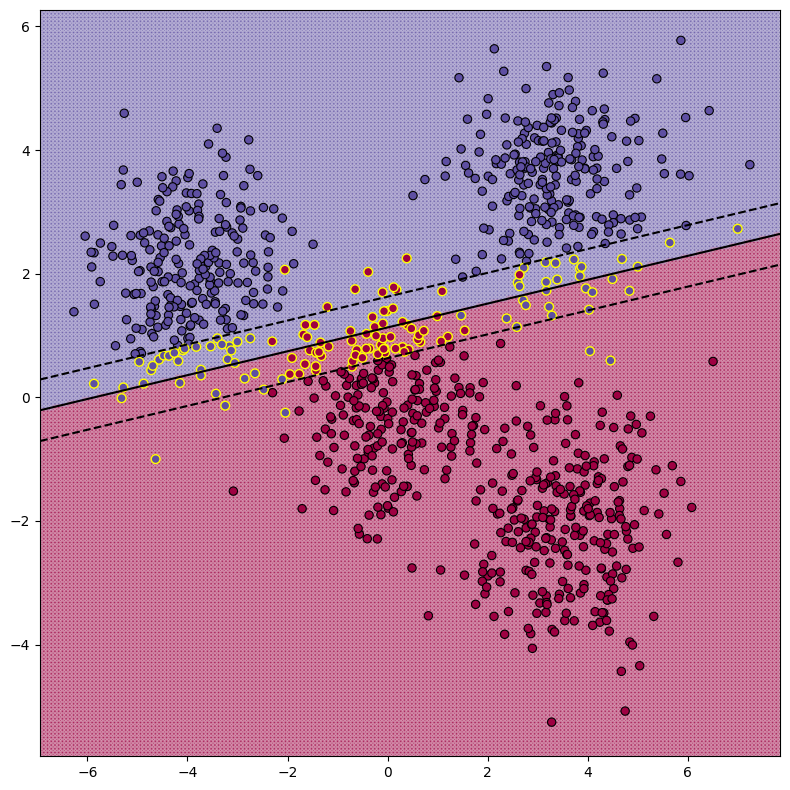

In [7]:
svm = LinearSVM(1)
svm.fit(X_blobs, y_blobs)
visualize(svm, X_blobs, y_blobs)
plt.show()

### Задание 2 (1 балл)
Перед реализацией ядерного SVM, реализуем функции, которые строят ядра.

#### Описание
`get_polynomial_kernel(power)` - возвращает полиномиальное ядро с заданной константой и степенью

`get_gaussian_kernel(sigma=1.)` - возвращает ядро Гаусса с заданным коэффицинтом сигма

In [8]:
def linear_kernel(x1: np.ndarray, x2: np.ndarray) -> np.ndarray:
    return x1.dot(x2.T)


def get_polynomial_kernel(c=1, power=2):
    def polynomial_kernel(x1: np.ndarray, x2: np.ndarray) -> np.ndarray:
         return (linear_kernel(x1, x2) + c) ** power

    return polynomial_kernel


def get_gaussian_kernel(sigma=1.0):

    def gaussian_kernel(x1: np.ndarray, x2: np.ndarray) -> np.ndarray:
        squared_distance = np.sum(np.square(x1 - x2))
        return np.exp(-squared_distance / (2 * sigma**2))

    return gaussian_kernel

### Задание 3 (2 балла)
Теперь перейдем к реализации самого kernel SVM.

#### Описание
`fit(X, y)` - обучает kernel SVM, решая задачу оптимизации при помощи `cvxopt.solvers.qp`

`decision_function(X)` - возвращает значение решающей функции (т.е. то число, от которого берем знак с целью узнать класс)

### Решение с помощью QP Solver

QP-solver решает такую задачу:

$\begin{cases}0.5 \cdot x^\text{T}Px + q^\text{T}x\rightarrow \min_x\\Gx \leq h\\Ax=b\end{cases}$

Будем решать двойственную задачу. Формулируется она так:

$\begin{cases}\sum \alpha_i - 0.5 \sum \alpha_i \alpha_j y_i y_j K(x_i, x_j) \rightarrow \max_{\alpha}\\ C \geq \alpha \geq 0 \\ y_i \alpha = 0 \end{cases}$

Сведем ее к задаче QP-solver'а:

$ x = \alpha \\ P =
\left[ y_i y_j K(y_i, y_j) \right] \\
q = \left[ -1
\right] \\
 G =
\left[
    \begin{array}{c}
      I\\
      \hline
      -I
    \end{array}
\right] \\ h = \left[
    \begin{array}{c}
      C \\
      \hline
      0
    \end{array}
\right] \\
b = 0\\
A = y^\text{T}$

В таком случае решающей функцией будет:

$a(x) = \text{sign} (\sum \alpha_i y_i K(x, x_i) + w_0)$, где $w_0 = \frac{1}{n}\sum\limits_{i=1}^{n}[y_i - \sum \alpha_j y_j K(x_i, x_j)]$

In [9]:
class KernelSVM:

    _X = None
    _y = None
    w0 = None
    alphas = None

    def __init__(self, C: float, kernel: Callable = linear_kernel):
        """SVM with specified kernel

        Args:
            C: Soft margin coefficient
            kernel: Callable kernel for kernel trick
        """
        self.C = C
        self.kernel = kernel
        self.support = None

    def fit(self, X: np.ndarray, y: np.ndarray):
        """Fit SVM using cvxopt.solvers.qp

        Args:
            X: Train data, [n_samles, n_features]
            y: Binary labels (-1 or +1), [n_samples,]
        """
        self._X = X
        self._y = y.reshape(-1, 1)
        n_samples, n_features = X.shape    

        K = np.zeros((n_samples, n_samples))
        for i in range(n_samples):
            for j in range(n_samples):
                K[i, j] = self.kernel(X[i], X[j])

        P = matrix(np.outer(y, y) * K)
        q = matrix(-np.ones((n_samples, 1)))

        G_upper = np.eye(n_samples)    
        G_lower = -np.eye(n_samples)  
        G = matrix(np.vstack([G_upper, G_lower]))

        h_upper = np.ones((n_samples, 1)) * self.C
        h_lower = np.zeros((n_samples, 1))
        h = matrix(np.vstack([h_upper, h_lower]))
        A = matrix(self._y.T.astype(float), tc='d')
        b = matrix(0.0, tc='d')

        solution = solvers.qp(P, q, G, h, A, b)
        self.alphas = np.ravel(solution['x'])

        alpha_tolerance = 1e-6
        self.support = [
            i for i in range(len(self.alphas)) 
            if self.alphas[i] > alpha_tolerance
        ]
        self._X_support = self._X[self.support]
        self._y_support = self._y[self.support]
        self.alphas_support = self.alphas[self.support]

        self.w0 = 0.0
        if len(self.support) > 0:
            for i in range(len(self.support)):
                kernel_sum = 0.0
                for alpha, label, sv in zip(self.alphas_support, 
                                            self._y_support.flatten(), 
                                            self._X_support):
                    kernel_sum += alpha * label * self.kernel(self._X_support[i], sv)
                
                self.w0 += self._y_support[i] - kernel_sum
            
            self.w0 /= len(self.support)


    def decision_function(self, X: np.ndarray) -> np.ndarray:
        """Calculate decision for the points, i.e. prediction without sign

        Args:
            X: Input data, [n_samples, n_features]

        Return:
            Decision for each input point, [n_samples, ]
        """
        if self.support is None:
            raise ValueError("Model not fitted")
        decisions = np.zeros(X.shape[0])
        for i, x in enumerate(X):
            kernel_sum = 0.0
            for alpha, label, sv in zip(self.alphas_support, 
                                    self._y_support.flatten(), 
                                    self._X_support):
                kernel_sum += alpha * label * self.kernel(x, sv)
            decisions[i] = kernel_sum + self.w0
        
        return decisions


    def predict(self, X: np.ndarray) -> np.ndarray:
        """Classify input points

        Args:
            X: Input data, [n_samples, n_features]

        Return:
            Predicited class for each point (-1 or +1), [n_samples, ]
        """
        return np.sign(self.decision_function(X))


/tmp/ipykernel_32740/983646261.py:92: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  decisions[i] = kernel_sum + self.w0


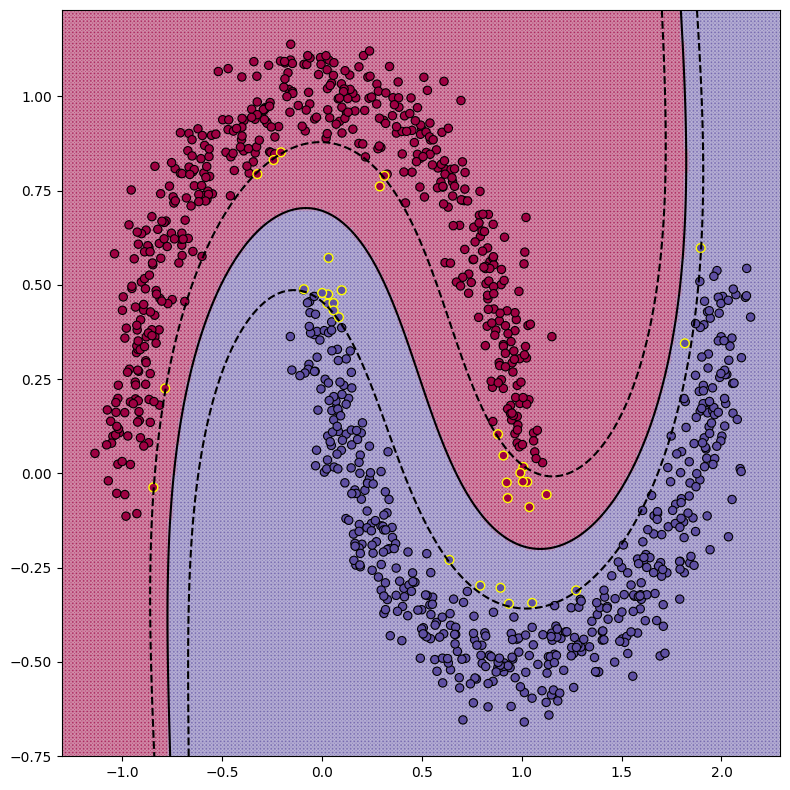

In [10]:
svm = KernelSVM(1, kernel=get_polynomial_kernel(1, 3))
svm.fit(X_moons, y_moons)
visualize(svm, X_moons, y_moons)
plt.show()

/tmp/ipykernel_32740/983646261.py:92: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  decisions[i] = kernel_sum + self.w0


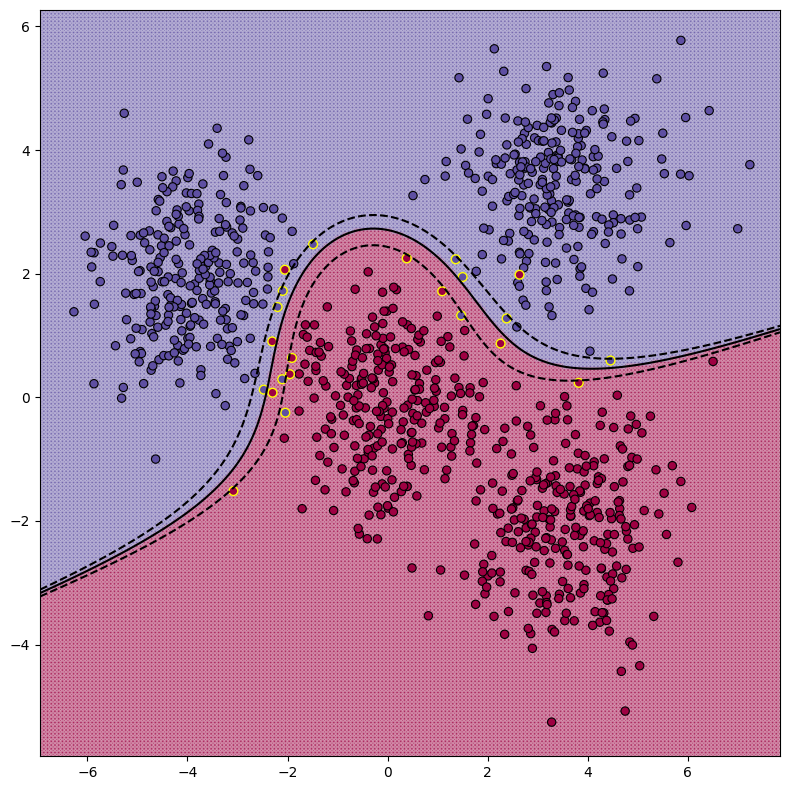

In [11]:
svm = KernelSVM(1, kernel=get_polynomial_kernel(1, 3))
svm.fit(X_blobs, y_blobs)
visualize(svm, X_blobs, y_blobs)
plt.show()

/tmp/ipykernel_32740/983646261.py:92: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  decisions[i] = kernel_sum + self.w0


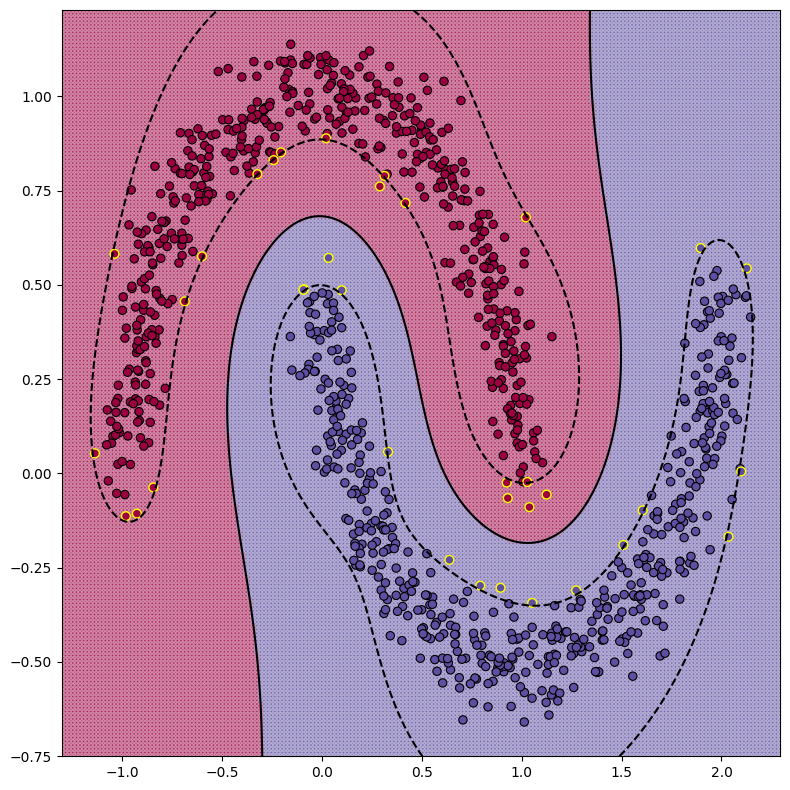

In [12]:
svm = KernelSVM(1, kernel=get_gaussian_kernel(0.4))
svm.fit(X_moons, y_moons)
visualize(svm, X_moons, y_moons)
plt.show()

/tmp/ipykernel_32740/983646261.py:92: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  decisions[i] = kernel_sum + self.w0


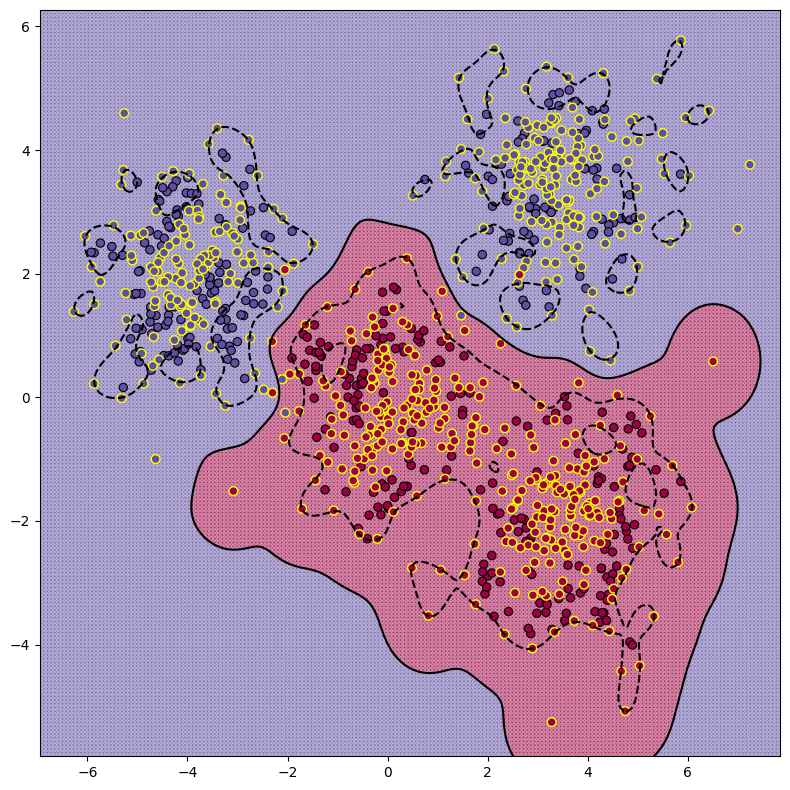

In [13]:
svm = KernelSVM(1, kernel=get_gaussian_kernel(0.4))
svm.fit(X_blobs, y_blobs)
visualize(svm, X_blobs, y_blobs)
plt.show()

### Задание 4 (2 балла)
Исследуйте и опишите влияние параметров каждого вида ядра на полученный классификатор. Что происходит при увеличении константы в полиномиальном ядре? При увеличении степени? Как влияет на результат сигма в ядре Гаусса?

__При выполнении этого задания стоит написать код, который визуализирует классификаторы с различными ядрами__

### Polynomial kernel

Группа: Влияние степени
Конфигурация: C=1, c=1, power=2


/tmp/ipykernel_32740/983646261.py:92: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  decisions[i] = kernel_sum + self.w0


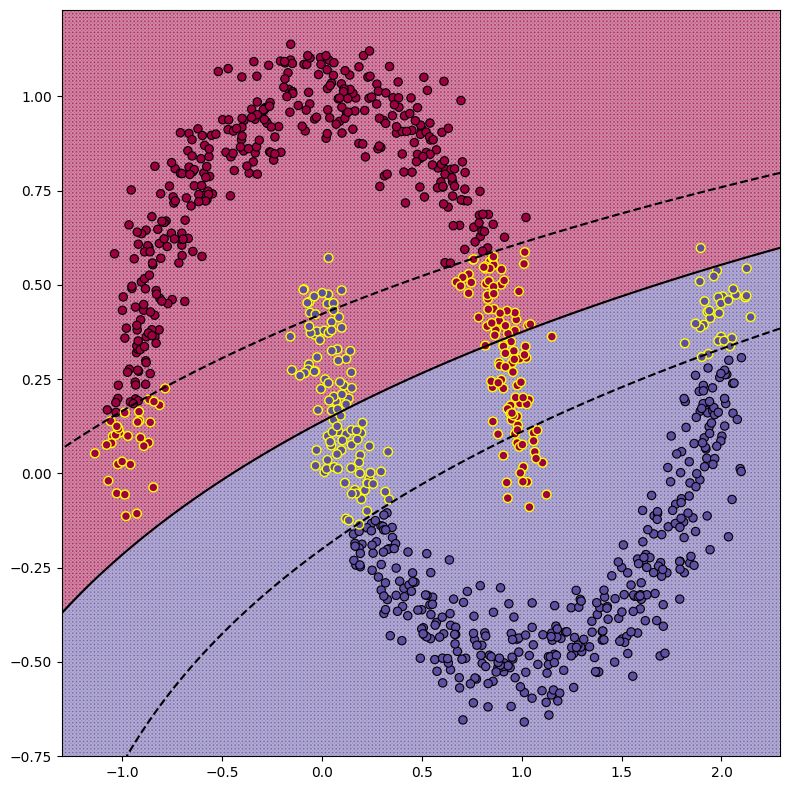

Конфигурация: C=1, c=1, power=3


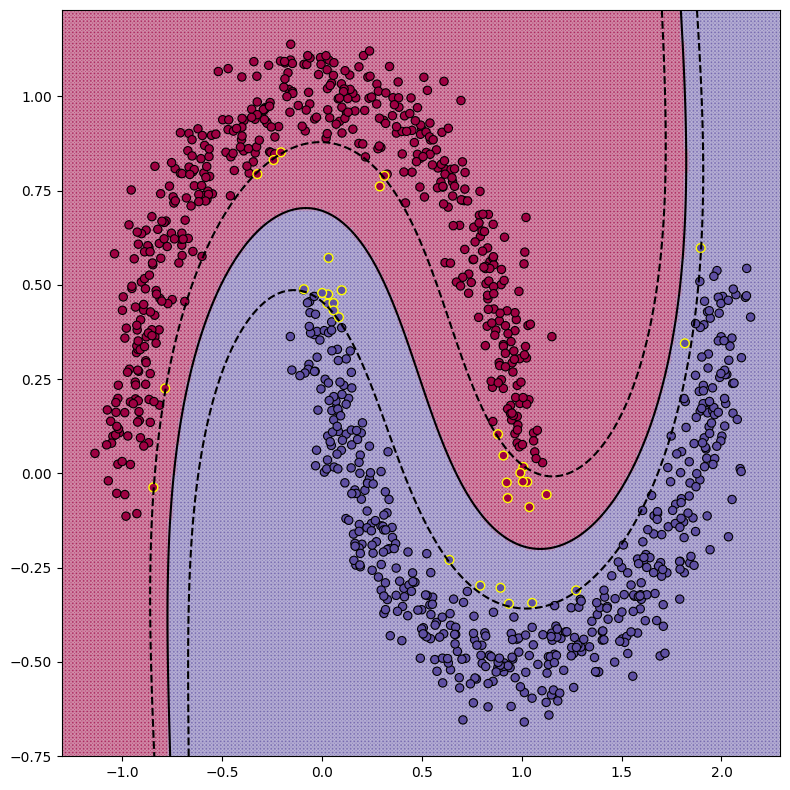

Конфигурация: C=1, c=1, power=4


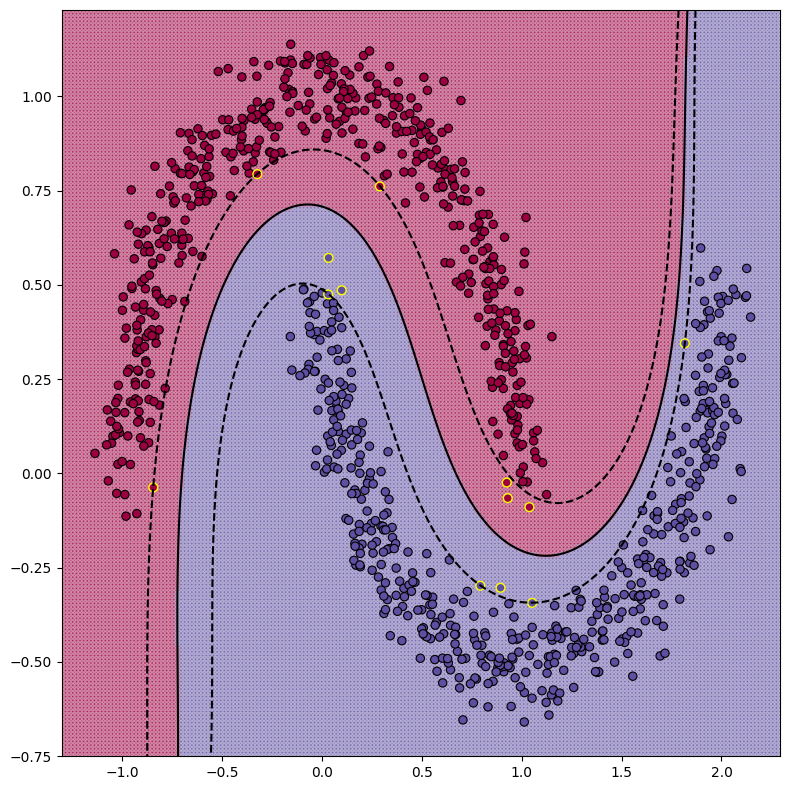

Конфигурация: C=1, c=1, power=5


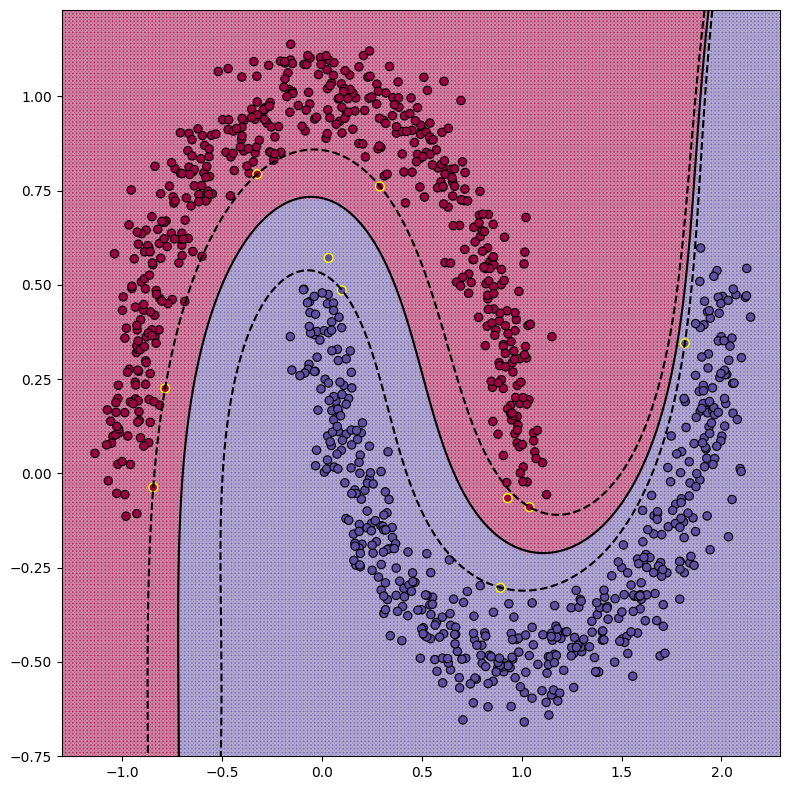

Группа: Влияние c
Конфигурация: C=1, c=0.1, power=3


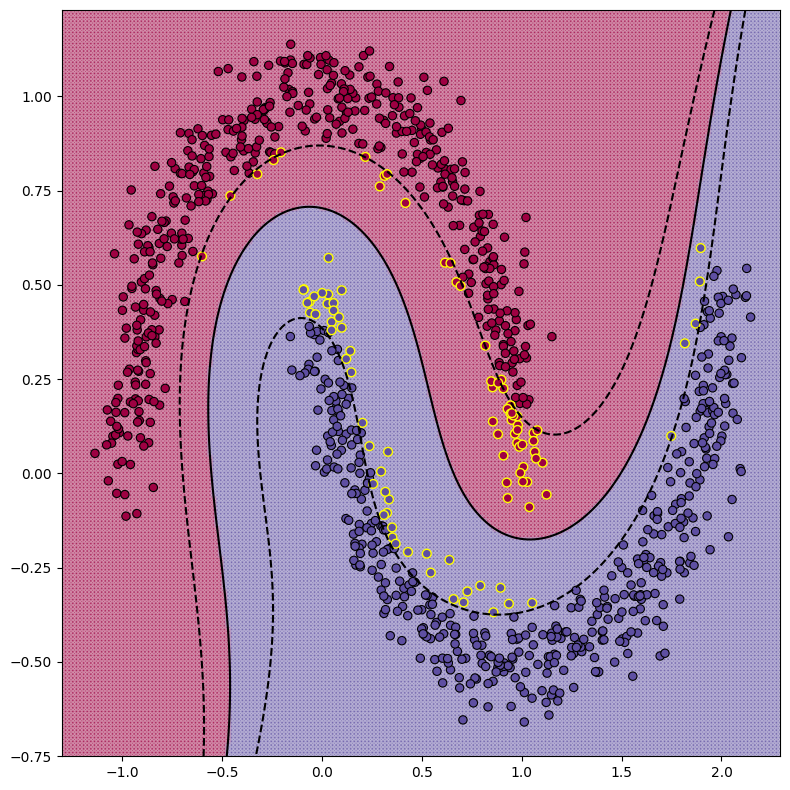

Конфигурация: C=1, c=1, power=3


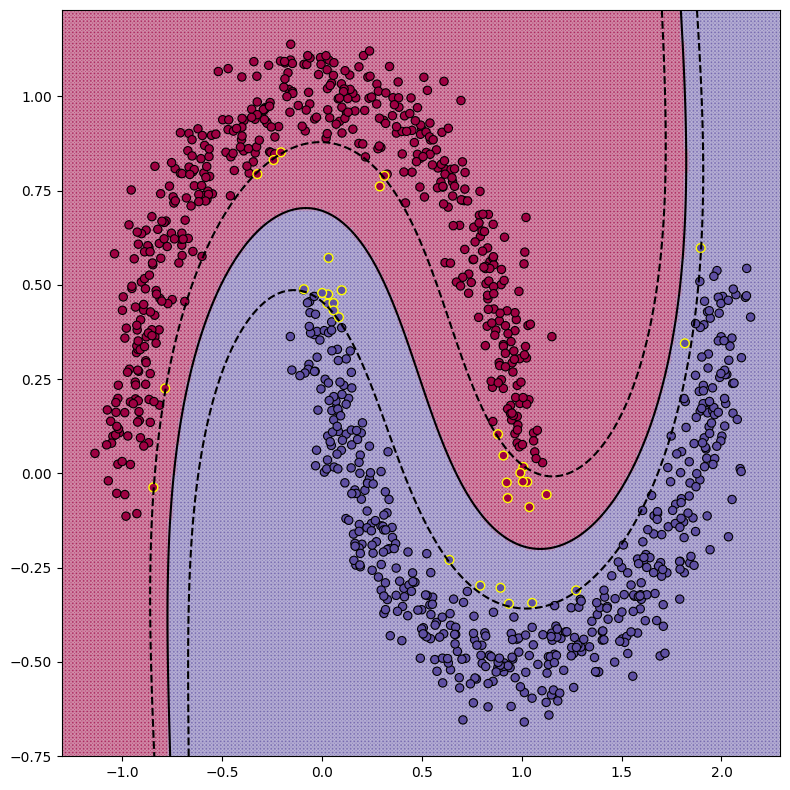

Конфигурация: C=1, c=10, power=3


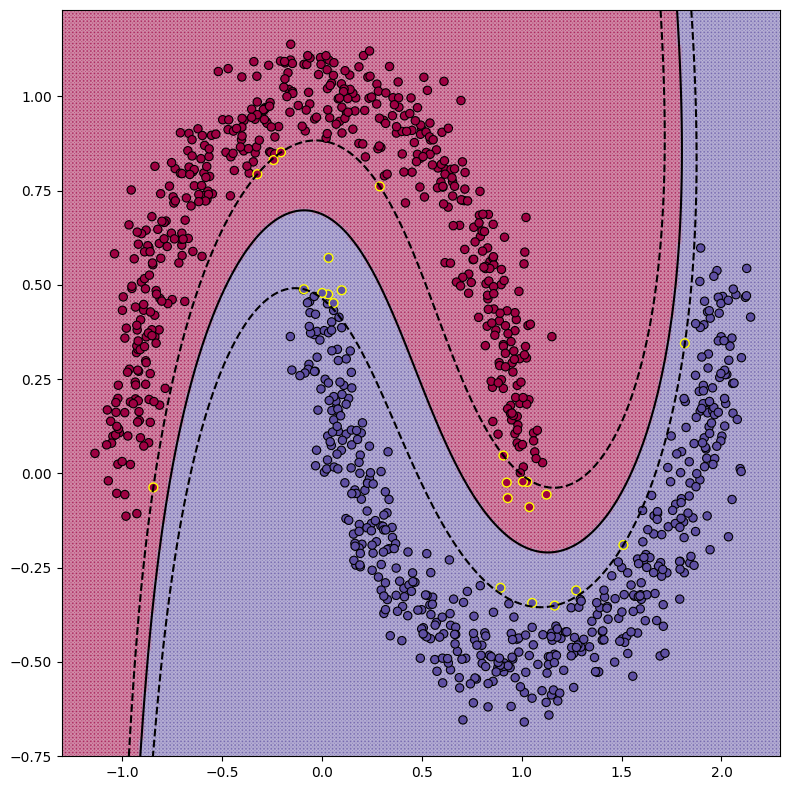

Конфигурация: C=1, c=100, power=3


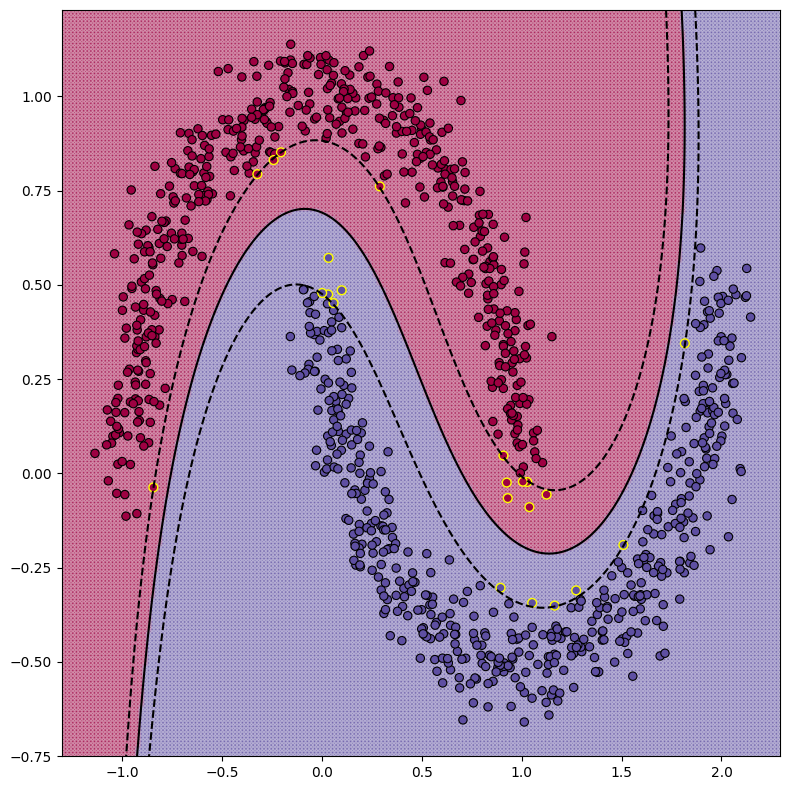

Группа: Влияние C
Конфигурация: C=0.1, c=1, power=3


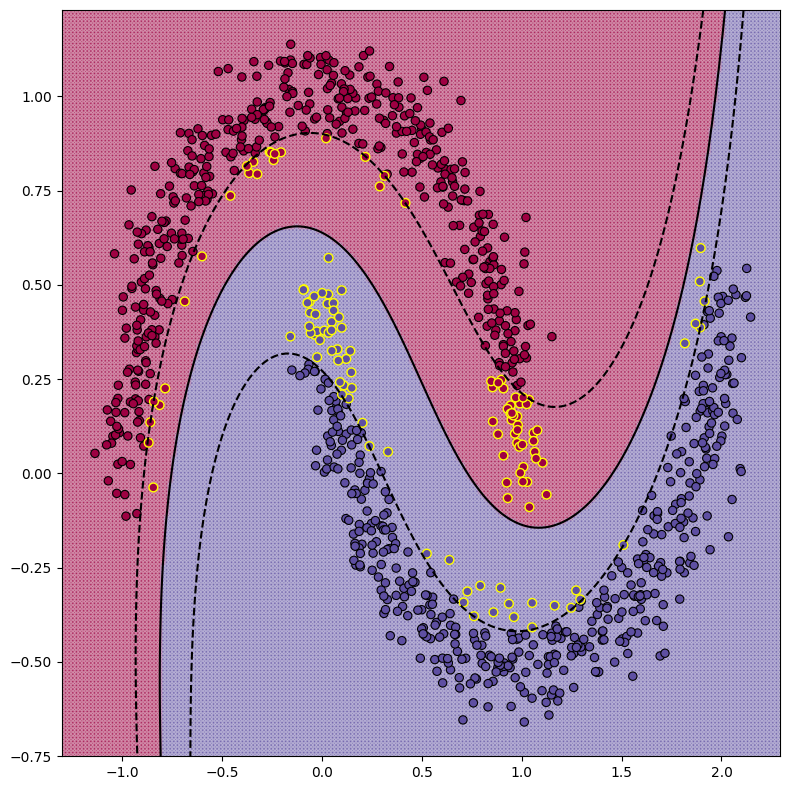

Конфигурация: C=1, c=1, power=3


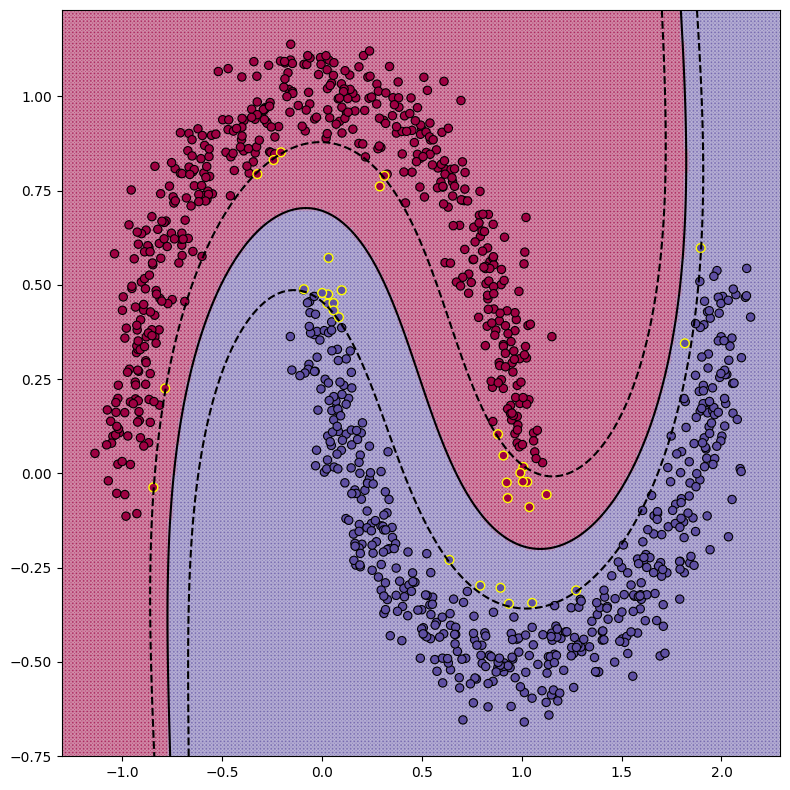

Конфигурация: C=10, c=1, power=3


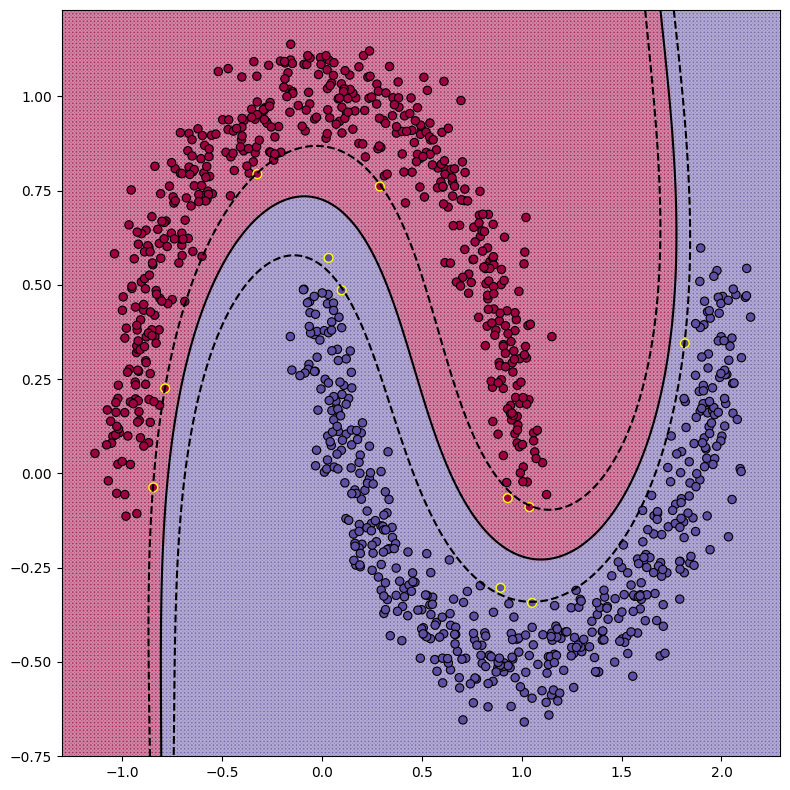

Конфигурация: C=100, c=1, power=3


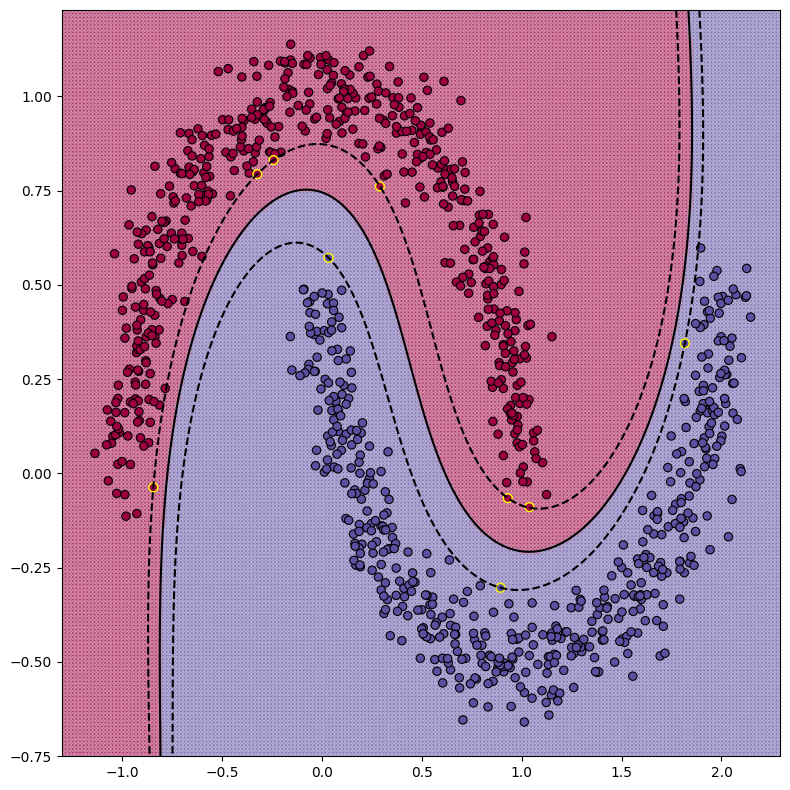

Группа: Комбинированные
Конфигурация: C=0.1, c=0.1, power=2


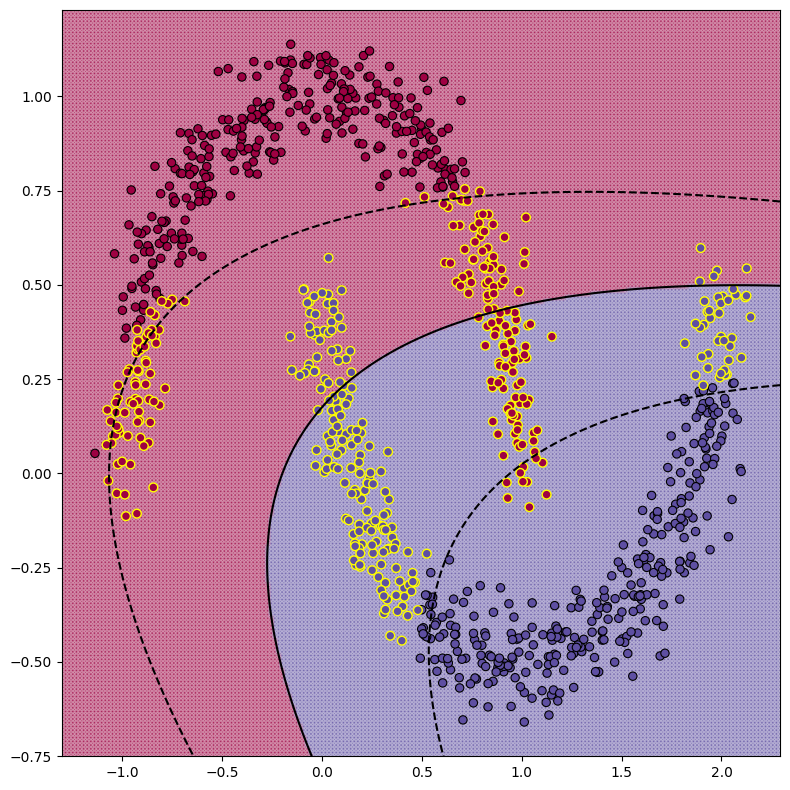

Конфигурация: C=10, c=10, power=4


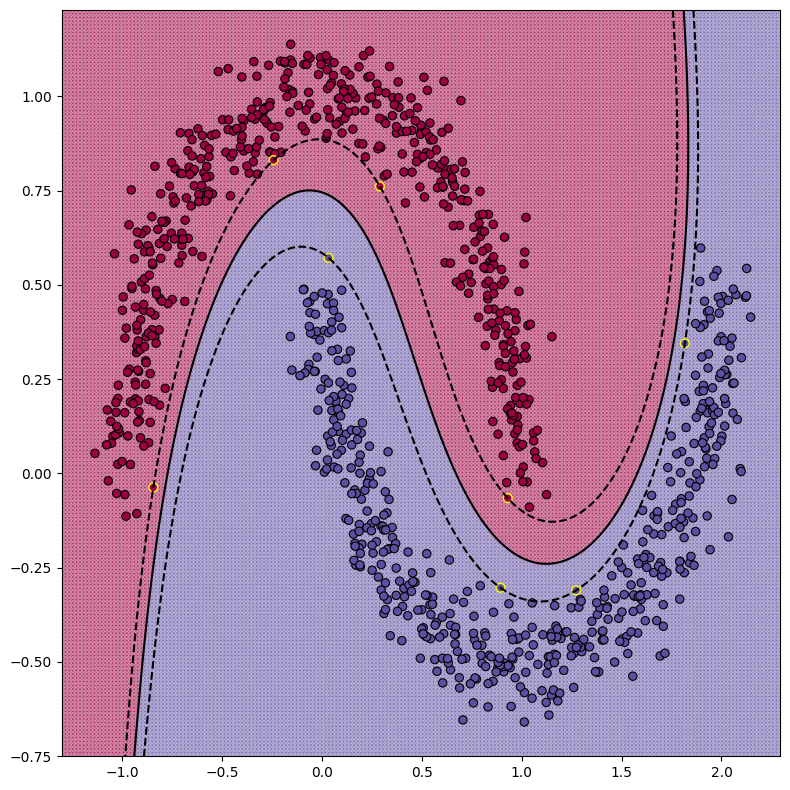

Конфигурация: C=1, c=0.5, power=6


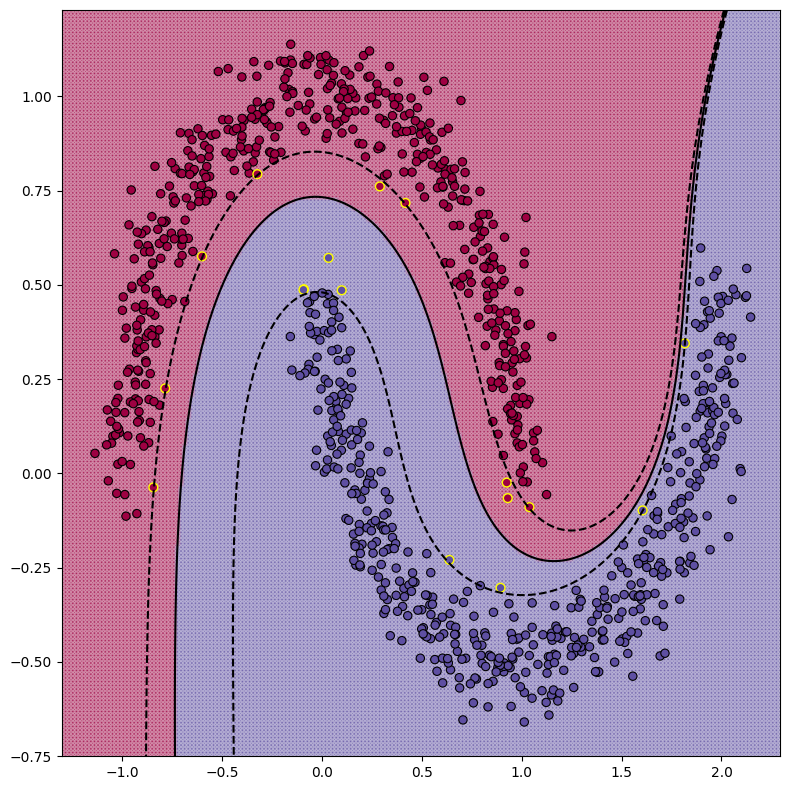

Конфигурация: C=1, c=1, power=1


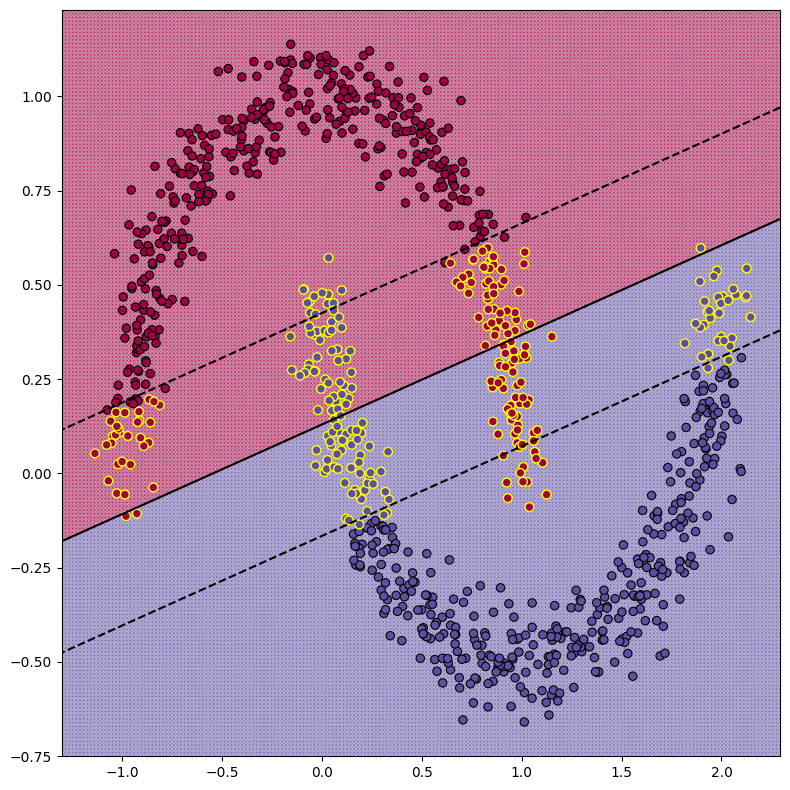

In [14]:
config_groups = [
    [
        {"C": 1, "c": 1, "power": 2, "group": "Влияние степени"},
        {"C": 1, "c": 1, "power": 3, "group": "Влияние степени"},
        {"C": 1, "c": 1, "power": 4, "group": "Влияние степени"},
        {"C": 1, "c": 1, "power": 5, "group": "Влияние степени"}
    ],

    [
        {"C": 1, "c": 0.1, "power": 3, "group": "Влияние c"},
        {"C": 1, "c": 1, "power": 3, "group": "Влияние c"},
        {"C": 1, "c": 10, "power": 3, "group": "Влияние c"},
        {"C": 1, "c": 100, "power": 3, "group": "Влияние c"}
    ],
    
    [
        {"C": 0.1, "c": 1, "power": 3, "group": "Влияние C"},
        {"C": 1, "c": 1, "power": 3, "group": "Влияние C"},
        {"C": 10, "c": 1, "power": 3, "group": "Влияние C"},
        {"C": 100, "c": 1, "power": 3, "group": "Влияние C"}
    ],
    
    [
        {"C": 0.1, "c": 0.1, "power": 2, "group": "Комбинированные"},
        {"C": 10, "c": 10, "power": 4, "group": "Комбинированные"},
        {"C": 1, "c": 0.5, "power": 6, "group": "Комбинированные"},
        {"C": 1, "c": 1, "power": 1, "group": "Комбинированные"}  
    ]
]

figures=[]

for idx, group_configs in enumerate(config_groups):
    print(f"Группа: {group_configs[idx]['group']}")
    for config in group_configs:
        print(f"Конфигурация: C={config['C']}, c={config['c']}, power={config['power']}")
        svm = KernelSVM(C=config["C"], kernel=get_polynomial_kernel(c=config["c"], power=config["power"]))
        svm.fit(X_moons, y_moons)
    
        visualize(svm, X_moons, y_moons)
        plt.show()  

**Вывод**: **c** влияет на смещение и гибкость границы, параметр **C** отвчечает за баланс между точностью и регуляризацией, а **power** определяет сложность модели, что позволяет подстраиваться под более нелинейные зависимости данных, но так же может вести к переобучению.

### RBF kernel


Sigma: 0.01


/tmp/ipykernel_32740/983646261.py:92: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  decisions[i] = kernel_sum + self.w0
/tmp/ipykernel_32740/20804266.py:19: UserWarning: Ignoring specified arguments in this call because figure with num: 1 already exists
  plt.figure(1, figsize=(8, 8))


Sigma: 0.1
Sigma: 0.3
Sigma: 0.5
Sigma: 1
Sigma: 2.5


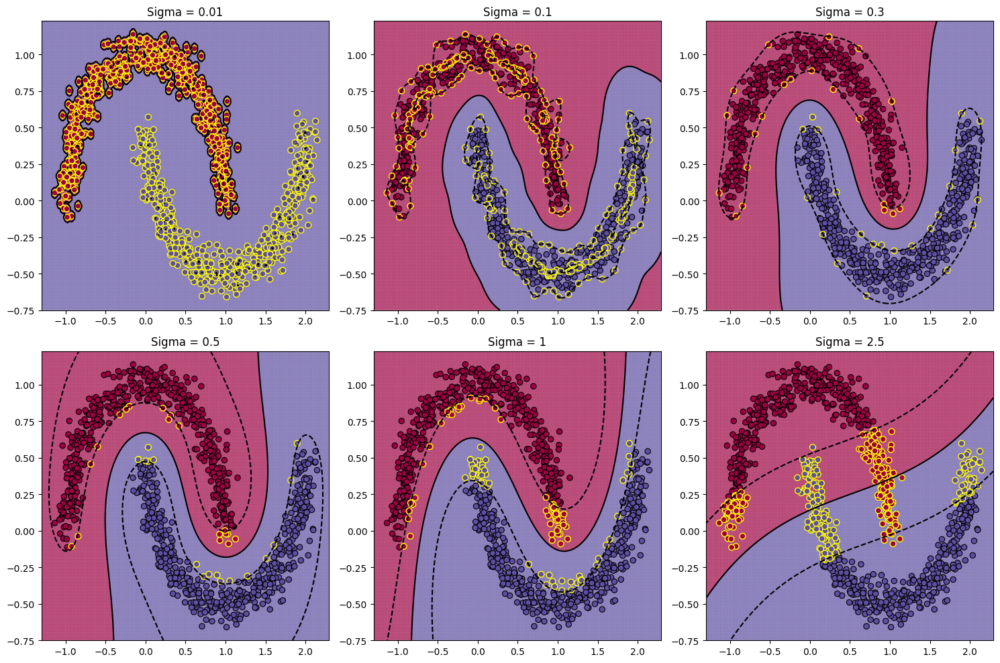

In [15]:
sigma_values = [0.01, 0.1, 0.3, 0.5, 1, 2.5]
n_cols = 3
n_rows = (len(sigma_values) + n_cols - 1) // n_cols

fig, axes = plt.subplots(n_rows, n_cols, figsize=(15, 10))
axes = axes.flatten()

for ax, sigma in zip(axes, sigma_values):
    print(f"Sigma: {sigma}")
    gaussian_kernel = get_gaussian_kernel(sigma)
    svm = KernelSVM(C=1, kernel=gaussian_kernel)
    svm.fit(X_moons, y_moons)
    
    plt.sca(ax)
    visualize(svm, X_moons, y_moons)
    ax.set_title(f"Sigma = {sigma}")

for i in range(len(sigma_values), len(axes)):
    axes[i].set_visible(False)

plt.tight_layout()
plt.show()

**Вывод**: При малых значениях параметра сигма разделяющая поверхность становится чрезмерно сложной и извилистой, что приводит к переобучению. При больших значениях граница упрощается до почти линейной теряя способность к обобощению нелинейных зависимостей

# Задание 5 (3 балла)

Поставьте эксперимент и сравните SVM с логистической регрессией на синтетических данных. Для этого для каждого датасета:

1. Воспользуйтесь реализацией логистической регрессии из `sklearn`
2. Подготовьте данные, преобразуйте их для лучшей разделимости, например, добавьте polynomial features
3. Зафиксируйте метрику
4. Подберите гиперпараметры обоих моделей
5. Напишите вывод, какая из моделей обучилась лучше и почему так вышло

In [16]:
from sklearn.linear_model import LogisticRegression
from sklearn.preprocessing import PolynomialFeatures, StandardScaler
from sklearn.metrics import accuracy_score, f1_score
from sklearn.model_selection import train_test_split
from sklearn.datasets import make_classification
from sklearn.pipeline import Pipeline

In [25]:
def generate_synthetic_data():
    datasets = {}
    X_linear, y_linear = make_classification(
        n_samples=1000, n_features=2, n_informative=2, n_redundant=0,
        n_clusters_per_class=1, random_state=20
    )
    y_linear = np.where(y_linear == 0, -1, 1)  
    datasets['linear'] = (X_linear, y_linear)
    
    X_nonlinear, y_nonlinear = make_classification(
        n_samples=1000, n_features=2, n_informative=2, n_redundant=0,
        n_clusters_per_class=2, random_state=20
    )
    y_nonlinear = np.where(y_nonlinear == 0, -1, 1)
    datasets['nonlinear'] = (X_nonlinear, y_nonlinear)
    
    X_noisy, y_noisy = make_classification(
        n_samples=1000, n_features=2, n_informative=2, n_redundant=0,
        flip_y=0.3, random_state=20
    )
    y_noisy = np.where(y_noisy == 0, -1, 1)
    datasets['noisy'] = (X_noisy, y_noisy)
    
    return datasets

In [26]:
def compare_models(datasets):
    results = {}
    
    for dataset_name, (X, y) in datasets.items():
        print(f"Dataset: {dataset_name}")
        X_train, X_test, y_train, y_test = train_test_split(
            X, y, test_size=0.3, random_state=20
        )
        
        y_train_lr = np.where(y_train == -1, 0, 1)
        y_test_lr = np.where(y_test == -1, 0, 1)
        
        poly_degree = 3 if dataset_name == 'nonlinear' else 2
        
        lr_pipeline = Pipeline([
            ('poly', PolynomialFeatures(degree=poly_degree)),
            ('scaler', StandardScaler()),
            ('lr', LogisticRegression(max_iter=1000, random_state=20))
        ])

        lr_params = {'lr__C': [0.1, 1, 10, 100]}
        best_lr_score = -1
        best_lr_model = None
        
        for C in lr_params['lr__C']:
            lr_pipeline.set_params(lr__C=C)
            lr_pipeline.fit(X_train, y_train_lr)
            score = lr_pipeline.score(X_test, y_test_lr)
            
            if score > best_lr_score:
                best_lr_score = score
                best_lr_model = lr_pipeline
                best_lr_C = C
        
        svm_params = {'C': [0.1, 1, 10, 100], 'power': [2, 3, 4]}
        best_svm_score = -1
        best_svm_model = None
        
        for C in svm_params['C']:
            for degree in svm_params['power']:
                kernel = get_polynomial_kernel(c=1, power=degree)
                svm = KernelSVM(C=C, kernel=kernel)
                svm.fit(X_train, y_train)
                predictions = svm.predict(X_test)
                score = accuracy_score(y_test, predictions)
                
                if score > best_svm_score:
                    best_svm_score = score
                    best_svm_model = svm
                    best_svm_C = C
                    best_svm_power = degree
        
        lr_pred = best_lr_model.predict(X_test)
        svm_pred = best_svm_model.predict(X_test)
        
        lr_accuracy = accuracy_score(y_test_lr, lr_pred)
        svm_accuracy = accuracy_score(y_test, svm_pred)
        
        lr_f1 = f1_score(y_test_lr, lr_pred)
        svm_f1 = f1_score(y_test, svm_pred)
        
        results[dataset_name] = {
            'Logistic Regression': {
                'best_params': {'C': best_lr_C},
                'accuracy': lr_accuracy,
                'f1_score': lr_f1
            },
            'SVM': {
                'best_params': {'C': best_svm_C, 'power': best_svm_power},
                'accuracy': svm_accuracy,
                'f1_score': svm_f1
            }
        }
    return results

In [27]:
def visualize_results(results, metric_type='accuracy'):
    datasets = list(results.keys())

    if metric_type == "accuracy":
        lr_metric = [results[d]['Logistic Regression']['accuracy'] for d in datasets]
        svm_metric = [results[d]['SVM']['accuracy'] for d in datasets]
    else:
        lr_metric = [results[d]['Logistic Regression']['f1_score'] for d in datasets]
        svm_metric = [results[d]['SVM']['f1_score'] for d in datasets]

    x = np.arange(len(datasets))
    width = 0.35
    
    _, ax = plt.subplots(figsize=(10, 6))
    bars1 = ax.bar(x - width/2, lr_metric, width, label='Logistic Regression')
    bars2 = ax.bar(x + width/2, svm_metric, width, label='SVM')
    
    ax.set_xlabel('Тип датасета')
    ax.set_ylabel(metric_type)
    ax.set_title('Сравнение Logistic Regression и SVM')
    ax.set_xticks(x)
    ax.set_xticklabels(['Линейные', 'Нелинейные', 'Зашумленные'])
    ax.legend()
    
    for bars in [bars1, bars2]:
        for bar in bars:
            height = bar.get_height()
            ax.annotate(f'{height:.3f}',
                        xy=(bar.get_x() + bar.get_width() / 2, height),
                        xytext=(0, 3),
                        textcoords="offset points",
                        ha='center', va='bottom')
    
    plt.tight_layout()
    plt.show()

Сравнение SVM и логистической регрессии на синтетических данных
Dataset: linear


/tmp/ipykernel_32740/983646261.py:92: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  decisions[i] = kernel_sum + self.w0
/tmp/ipykernel_32740/983646261.py:92: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  decisions[i] = kernel_sum + self.w0
/tmp/ipykernel_32740/983646261.py:92: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  decisions[i] = kernel_sum + self.w0
/tmp/ipykernel_32740/983646261.py:92: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is

Dataset: nonlinear


/tmp/ipykernel_32740/983646261.py:92: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  decisions[i] = kernel_sum + self.w0
/tmp/ipykernel_32740/983646261.py:92: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  decisions[i] = kernel_sum + self.w0
/tmp/ipykernel_32740/983646261.py:92: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  decisions[i] = kernel_sum + self.w0
/tmp/ipykernel_32740/983646261.py:92: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is

Dataset: noisy


/tmp/ipykernel_32740/983646261.py:92: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  decisions[i] = kernel_sum + self.w0
/tmp/ipykernel_32740/983646261.py:92: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  decisions[i] = kernel_sum + self.w0
/tmp/ipykernel_32740/983646261.py:92: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  decisions[i] = kernel_sum + self.w0
/tmp/ipykernel_32740/983646261.py:92: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is

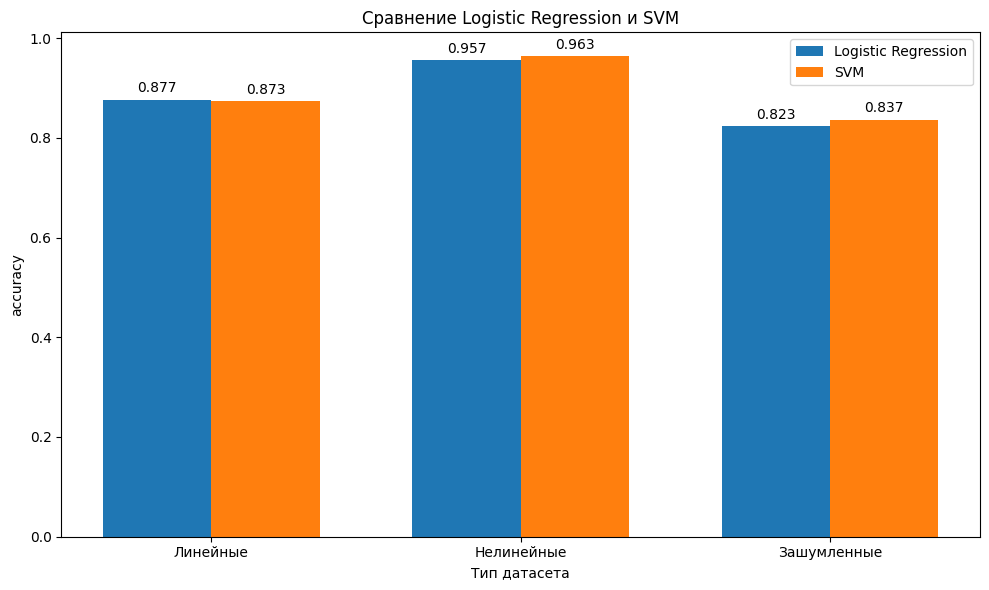

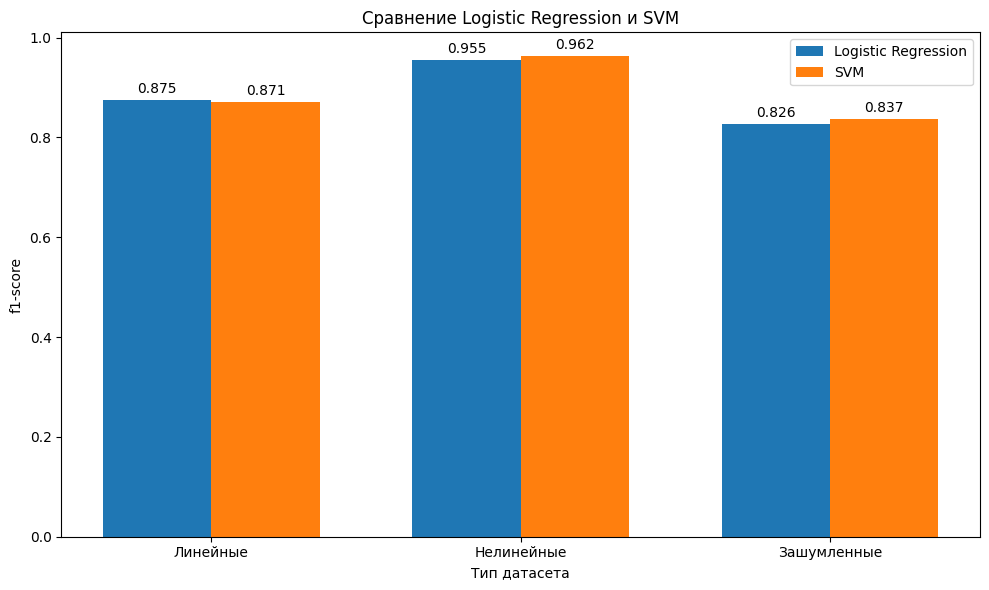

linear
Model logistic regression, accuracy=0.8766666666666667, f1-score=0.8754208754208754
Model SVM, accuracy=0.8733333333333333, f1-score=0.8707482993197279
nonlinear
Model logistic regression, accuracy=0.9566666666666667, f1-score=0.9550173010380623
Model SVM, accuracy=0.9633333333333334, f1-score=0.962457337883959
noisy
Model logistic regression, accuracy=0.8233333333333334, f1-score=0.8262295081967214
Model SVM, accuracy=0.8366666666666667, f1-score=0.8372093023255814


In [28]:

print("Сравнение SVM и логистической регрессии на синтетических данных")
datasets = generate_synthetic_data()
results = compare_models(datasets)
visualize_results(results, 'accuracy')
visualize_results(results, 'f1-score')

for dataset_name in datasets.keys():
    lr_acc = results[dataset_name]['Logistic Regression']['accuracy']
    svm_acc = results[dataset_name]['SVM']['accuracy']
    lr_f1_score = results[dataset_name]['Logistic Regression']['f1_score']
    svm_f1_score = results[dataset_name]['SVM']['f1_score']
    print(dataset_name)
    print(f"Model logistic regression, accuracy={lr_acc}, f1-score={lr_f1_score}")
    print(f"Model SVM, accuracy={svm_acc}, f1-score={svm_f1_score}")



По полученным результатам видно, что SVM, хоть и не сильно, но лучше справилась со всеми датасетами, кроме датасета с линейно разделимыми данными.